# Text redaction experiments

this notebook contains the experiments presented in the paper, with the models being evaluated in this notebook. For convenience we have saved the predictions of the neural models in the LRE format. If you want to train the neural models yourself, please have a look at the README file for instructions on have to train the models with the config files that we provide.

In [1]:
import cv2
from PIL import Image
def load_image(image_path: str) -> np.ndarray:
    """
    Function that loads an image from a path.
    :param image_path: string specifying the path to the image
    :return: Numpy array with the image in BGR format.
    """
    image = Image.open(image_path)
    return image

NameError: name 'np' is not defined

In [ ]:
def create_LRE_masks_from_json(json_filepath: str):
    LRE_annotations = []
    
    with open(json_filepath, 'r') as f:
        contents = json.load(f)
        
    dataset = COCO(json_filepath)
    image_ids = dataset.getImgIds()
    for image_id in tqdm(image_ids):
        gt_annotations = dataset.getAnnIds(imgIds=image_id)
        for annot in gt_annotations:
            loaded_annot = dataset.loadAnns(annot)[0]
            mask = dataset.annToMask(loaded_annot)
            LRE_string = encode(mask)
            loaded_annot['segmentation'] = LRE_string
            LRE_annotations.append(loaded_annot)
    contents['annotations'] = LRE_annotations
    new_filename = json_filepath.replace('.json', '_LRE.json')
    with open(new_filename, 'w') as f:
        json.dump(contents, f)
    

In [102]:
create_LRE_masks_from_json('../dataset/test/classic_test.json')

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


  0%|                                                   | 0/284 [00:00<?, ?it/s]

[[298, 794, 2176, 794, 2176, 1056, 298, 1056]]
{'bbox': [298, 794, 1878, 262], 'area': 492036, 'iscrowd': 0, 'image_id': 1, 'bbox_mode': 1, 'segmentation': [[298, 794, 2176, 794, 2176, 1056, 298, 1056]], 'category_id': 1, 'id': 1, 'type': 'border'}


TypeError: frPyObjects() takes exactly 3 positional arguments (1 given)

In [2]:
import os
import json
import torch
import numpy as np
import pandas as pd
from PIL import Image
from tqdm import tqdm
import pycocotools.coco
from skimage import measure
from torchvision.ops import nms
import matplotlib.pyplot as plt
from pycocotools.coco import COCO
import matplotlib.pyplot as plt
from pycocotools.mask import decode, encode, merge, iou, area, frPyObjects    

In [3]:
def annots_to_masks(annotations):
    predicted_masks = [decode(annot['segmentation']) for annot in annotations]
    scores = [annot['score'] for annot in annotations]
    pred_masks = remove_box_overlap(predicted_masks, scores, score_t=0.50, iou_t=0.50)
    return pred_masks

In [4]:
import json
import numpy as np
from pycocotools import mask


def PrepAnnos(annotations):
    a = []
    masks = annots_to_masks(annotations)
    for i in range(len(masks)):
        #ground_truth_binary_mask = decode(annotation['segmentation'])
        fortran_ground_truth_binary_mask = np.asfortranarray(masks[i])
        encoded_ground_truth = mask.encode(fortran_ground_truth_binary_mask)
        ground_truth_area = mask.area(encoded_ground_truth)
        ground_truth_bounding_box = mask.toBbox(encoded_ground_truth)
        contours = measure.find_contours(masks[i], 0.5)

        annotation = {
                "segmentation": [],
                "area": ground_truth_area.tolist(),
                "iscrowd": 0,
                "image_id": 123,
                "bbox": ground_truth_bounding_box.tolist(),
                "category_id": 1,
                "id": 1
            }

        for contour in contours:
            contour = np.flip(contour, axis=1)
            segmentation = contour.ravel().tolist()
            annotation["segmentation"].append(segmentation)
        a.append(annotation)
    return a
    

In [5]:
with open('../model_outputs/SwinBaseCOCO/inference/coco_instances_results.json', 'r') as json_file:
    coco_results = json.load(json_file)

FileNotFoundError: [Errno 2] No such file or directory: '../model_outputs/SwinBaseCOCO/inference/coco_instances_results.json'

In [6]:
for i in range(len(coco_results)):
    coco_results[i]['id'] = i+1
    coco_results[i]['iscrowd'] = False

NameError: name 'coco_results' is not defined

In [461]:
data_df = pd.read_csv('../datasets/data_complete.csv')

In [462]:
with open('../datasets/classic/test/classic_test.json', 'r') as json_file:
    coco_gold_standard = json.load(json_file)

In [463]:
pred_dict = dict(coco_gold_standard)
pred_dict['annotations'] = coco_results

In [464]:
with open('test.json', 'w') as f:
    json.dump(pred_dict, f)

In [465]:
pred_set = COCO('test.json')
image_ids = coco_dataset.getImgIds()

loading annotations into memory...
Done (t=0.02s)
creating index...
index created!
loading annotations into memory...
Done (t=0.38s)
creating index...
index created!


In [431]:
len(coco_dataset.getImgIds())

284

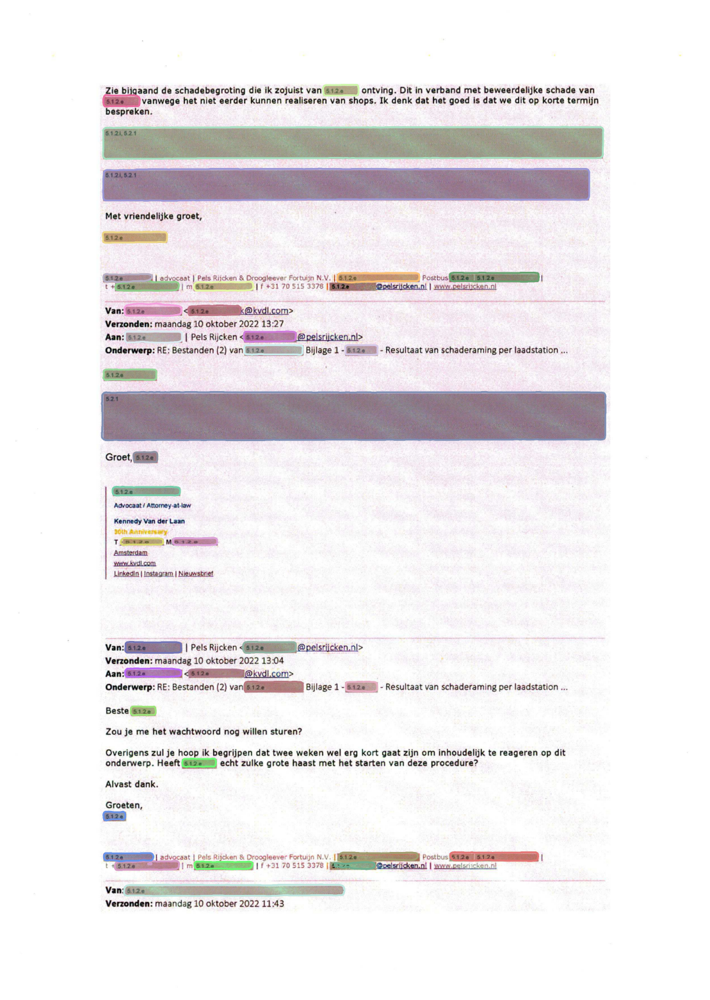

In [489]:
plt.rcParams["figure.figsize"] = (20, 20)
img_id = [item['id'] for item in coco_gold_standard['images'] if item['file_name'] == 'Bijlagen 2 bij Besluit op Woo-verzoek over uitvoering geven door de Staat aan het vonnis van de rechtbank van 14 april 2021-30.png'][0]
#img_id = image_ids[111] # 30,31,40 is goed

img_info = pred_set.loadImgs([img_id])[0]
img_file_name = img_info["file_name"]
ann_ids = pred_set.getAnnIds(imgIds=[img_id], iscrowd=None)
anns = pred_set.loadAnns(ann_ids)
anns = PrepAnnos(anns)
# Use URL to load image.
im = Image.open(os.path.join('../datasets/classic/test/images', img_file_name))

# Save image and its labeled version.
plt.axis("off")
plt.imshow(np.asarray(im))
#plt.savefig(f"{img_id}.jpg", bbox_inches="tight", pad_inches=0)
# Plot segmentation and bounding box.
pred_set.showAnns(anns, draw_bbox=False)
plt.show()

In [640]:
o = evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/test_stuff/coco_instances_results.json',
                                         score_treshold = 0.7)

100%|█████████████████████████████████████████| 439/439 [02:21<00:00,  3.11it/s]


In [785]:
mask2former_all = evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/Mask2Former_extended/coco_instances_results.json',
                                         score_treshold = 0.7)

100%|█████████████████████████████████████████| 439/439 [02:13<00:00,  3.29it/s]

[[1.         0.11927504]
 [0.11927504 1.        ]]


In [797]:
def get_type_stats(df):
    df['SQ'] = df['IOU'] / (df['TP'] + 0.00001)
    df['P'] = (df['TP']) /(df['TP'] + df['FP']+0.000000001)
    df['R'] = (df['TP']) /(df['TP'] + df['FN']+0.000000001)
    return df[['P', 'R']].mean(axis=0)

In [799]:
for t in mask2former_all['type'].unique():
    print(t)
    print(get_type_stats(mask2former_all[mask2former_all['type'] == t]))

no_annotation
P    0.0
R    0.0
dtype: float64
border
P    0.742065
R    0.677698
dtype: float64
gray
P    0.888659
R    0.901037
dtype: float64
black
P    0.961576
R    0.970637
dtype: float64
color
P    0.970501
R    0.908098
dtype: float64


/var/folders/1l/3m50rd612293xlpk2jrpyqbm0000gn/T/ipykernel_48939/1150144762.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['SQ'] = df['IOU'] / (df['TP'] + 0.00001)
/var/folders/1l/3m50rd612293xlpk2jrpyqbm0000gn/T/ipykernel_48939/1150144762.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df['P'] = (df['TP']) /(df['TP'] + df['FP']+0.000000001)
/var/folders/1l/3m50rd612293xlpk2jrpyqbm0000gn/T/ipykernel_48939/1150144762.py:4: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice 

In [565]:
model_output = evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/MaskRCNN_extended/coco_instances_results.json',
                                         score_treshold = 0.7)

100%|█████████████████████████████████████████| 439/439 [02:11<00:00,  3.34it/s]


In [568]:
model_output[model_output['type'] == 'no_annotation']['FP'].sum()

184

In [7]:
from pycocotools.mask import decode, encode, merge, area, frPyObjects, toBbox  
from pycocotools.mask import iou as mask_iou

def evaluate_model_predictions(gold_standard_json, predicted_json, score_treshold: float=0.5):
    """
    the predictions returned by the Detectron2 and Mask2Former libraries are not completely 
    in the correct format for a coca dataset, and therefore we will work with the raw dicts
    to make the code a bit more clear. This does not infuence the evaluation process.
    """
    
    dataset_scores = {}
    
    with open(gold_standard_json, 'r') as f:
        ground_truth_json = json.load(f)
        
    all_gts = []
    all_ious = []
    
    with open(predicted_json, 'r') as f:
        predicted_json = json.load(f)
        
    # Add ids to anontations
    for i in range(len(predicted_json)):
        predicted_json[i]['id'] = i+1
        
    
    for image in tqdm(ground_truth_json['images']):
        image_id = image['id']
        scores = {'TP': [], 'FP': [], 'FN': [], 'IOU': []}
        
        
        ground_truth_annotations = [item for item in ground_truth_json['annotations'] if item['image_id'] == image_id]
        predicted_annotations = [item for item in predicted_json if item['image_id'] == image_id]
        filtered_predicted_annotations = [item for item in predicted_annotations if area(item['segmentation']) > 0 and (item['score'] > score_treshold)]
        TP = []
        IOU = []
        
        # Next we will have to filter the annotations, as some have an overlap that is too big
        # or where the confidence threshold is too low.
        ground_truth_indices = [item['id'] for item in ground_truth_annotations]
        pred_indices = [item['id'] for item in filtered_predicted_annotations]

        
        for gt_annot in ground_truth_annotations:
            for pred_annot in filtered_predicted_annotations:
                
                gt_mask = gt_annot['segmentation']
                pred_mask = pred_annot['segmentation']
                
                combined_area = area(merge([gt_mask, pred_mask]))
                intersected_area = area(merge([gt_mask, pred_mask], intersect=True))
                iou_score = intersected_area/combined_area
                
                if iou_score > 0.5:
                    TP.append([gt_annot['id'], pred_annot['id']])
                    all_gts.append(area(gt_mask))
                    all_ious.append(iou_score)
                    IOU.append(iou_score)

        FP = set(pred_indices) - set([item[1] for item in TP])
        FN = set(ground_truth_indices) - set([item[0] for item in TP])
        
        scores['TP'] = len(TP)
        scores['FP'] = len(FP)
        scores['FN'] = len(FN)
        scores['IOU'] = sum(IOU)
        scores['type'] = image['type']
        dataset_scores[image['file_name']] = scores
        
    print(np.corrcoef(all_gts, all_ious))
    return pd.DataFrame(dataset_scores).T
    

In [26]:
model_output_mask2former = evaluate_model_predictions('../dataset/test/classic_test.json', '../model_outputs/Mask2Former_clean/coco_instances_results.json',
                                         score_treshold = 0.50)

100%|█████████████████████████████████████████| 284/284 [00:45<00:00,  6.22it/s]

[[1.         0.08174989]
 [0.08174989 1.        ]]


In [27]:
metric_calculation(model_output_mask2former)

{'PQ': 0.73, 'SQ': 0.83, 'RQ': 0.87, 'P': 0.92, 'R': 0.83}

In [28]:
model_output_mask2former[model_output_mask2former['type'] == 'no_annotation']['FP'].sum

<bound method NDFrame._add_numeric_operations.<locals>.sum of Series([], Name: FP, dtype: object)>

In [667]:
model_output_mask2former['type'].value_counts()

no_annotation    155
gray             114
black             94
border            51
color             25
Name: type, dtype: int64

In [11]:
import torchvision.transforms.functional as F

plt.rcParams["savefig.bbox"] = "tight"


def show(imgs):
    if not isinstance(imgs, list):
        imgs = [imgs]
    fix, axs = plt.subplots(ncols=len(imgs), squeeze=False)
    for i, img in enumerate(imgs):
        img = img.detach()
        img = F.to_pil_image(img)
        axs[0, i].imshow(np.asarray(img))
        axs[0, i].set(xticklabels=[], yticklabels=[], xticks=[], yticks=[])

In [12]:
# write a function that can nicely display ground truth and predicted and ground truth masks
from torchvision.utils import draw_segmentation_masks
def visualize_annotations(image_filename, gold_standard_json, predicted_json, score_treshold: float=0.5):
    plt.rcParams["figure.figsize"] = (20, 20)
    image_path = os.path.join("/".join(gold_standard_json.split('/')[:-1]), 'images', image_filename)
    im_arr = torch.from_numpy(np.array(load_image(image_path))).permute(2, 0, 1)
    print(im_arr.shape)

    with open(gold_standard_json, 'r') as f:
        ground_truth_json = json.load(f)
        
    
    with open(predicted_json, 'r') as f:
        predicted_json = json.load(f)
        
    # Add ids to anontations
    for i in range(len(predicted_json)):
        predicted_json[i]['id'] = i+1
        
    
    image = [item for item in ground_truth_json['images'] if item['file_name'] == image_filename][0]
    image_id = image['id']
    scores = {'TP': [], 'FP': [], 'FN': [], 'IOU': []}

    ground_truth_annotations = [item for item in ground_truth_json['annotations'] if item['image_id'] == image_id]
    predicted_annotations = [item for item in predicted_json if item['image_id'] == image_id]
    filtered_predicted_annotations = [item for item in predicted_annotations if area(item['segmentation']) > 0 and (item['score'] > score_treshold)]

    TP = []
    IOU = []

    # Next we will have to filter the annotations, as some have an overlap that is too big
    # or where the confidence threshold is too low.
    ground_truth_indices = [item['id'] for item in ground_truth_annotations]
    pred_indices = [item['id'] for item in filtered_predicted_annotations]


    for gt_annot in ground_truth_annotations:
        for pred_annot in filtered_predicted_annotations:

            gt_mask = gt_annot['segmentation']
            pred_mask = pred_annot['segmentation']

            combined_area = area(merge([gt_mask, pred_mask]))
            intersected_area = area(merge([gt_mask, pred_mask], intersect=True))
            iou_score = intersected_area/combined_area

            if iou_score > 0.5:
                TP.append([gt_annot['id'], pred_annot['id']])
                IOU.append(iou_score)

    FP = set(pred_indices) - set([item[1] for item in TP])
    FN = set(ground_truth_indices) - set([item[0] for item in TP])
    FP_masks = [decode(item['segmentation']) for item in filtered_predicted_annotations if item['id'] in FP]
    FN_masks = [decode(item['segmentation']) for item in ground_truth_annotations if item['id'] in FN]
    TP_masks = [decode(item['segmentation']) for item in filtered_predicted_annotations if item['id'] in [it[1] for it in TP]]
        
    if FP_masks:
        FP_masks = np.stack(FP_masks).astype(bool)
    if FN_masks:
        FN_masks = np.stack(FN_masks).astype(bool)
    if TP_masks:
        TP_masks = np.stack(TP_masks).astype(bool)
    
    all_masks = np.concatenate([item for item in [FP_masks, FN_masks, TP_masks] if isinstance(item, np.ndarray)])
    colors = ['red' for _ in range(len(FP_masks))] +  ['yellow' for _ in range(len(FN_masks))] + ['green' for _ in range(len(TP_masks))]
    show(draw_segmentation_masks(im_arr, torch.tensor(all_masks).bool(), colors=colors))
    plt.show()

In [13]:
def compute_mask_iou(mask1, mask2):
    combined_area = area(merge([mask1, mask2]))
    intersected_area = area(merge([mask1, mask2], intersect=True))
    return intersected_area/combined_area

In [14]:
# write a function that can nicely display ground truth and predicted and ground truth masks
from torchvision.utils import draw_bounding_boxes
from torchvision.ops import box_convert
def visualize_bounding_boxes(image_filename, gold_standard_json, predicted_json, score_treshold: float=0.80):
    plt.rcParams["figure.figsize"] = (20, 20)
    image_path = os.path.join("/".join(gold_standard_json.split('/')[:-1]), 'images', image_filename)
    im_arr = torch.from_numpy(np.array(load_image(image_path))).permute(2, 0, 1)
    print(im_arr.shape)

    with open(gold_standard_json, 'r') as f:
        ground_truth_json = json.load(f)
        
    
    with open(predicted_json, 'r') as f:
        predicted_json = json.load(f)
        
    # Add ids to anontations
    for i in range(len(predicted_json)):
        predicted_json[i]['id'] = i+1
        
    
    image = [item for item in ground_truth_json['images'] if item['file_name'] == image_filename][0]
    image_id = image['id']
    scores = {'TP': [], 'FP': [], 'FN': [], 'IOU': []}

    ground_truth_annotations = [item for item in ground_truth_json['annotations'] if item['image_id'] == image_id]
    predicted_annotations = [item for item in predicted_json if item['image_id'] == image_id]
    filtered_predicted_annotations = [item for item in predicted_annotations if area(item['segmentation']) > 0 and (item['score'] > score_treshold)]
    
    TP = []
    IOU = []

    # Next we will have to filter the annotations, as some have an overlap that is too big
    # or where the confidence threshold is too low.
    ground_truth_indices = [item['id'] for item in ground_truth_annotations]
    pred_indices = [item['id'] for item in filtered_predicted_annotations]


    for gt_annot in ground_truth_annotations:
        for pred_annot in filtered_predicted_annotations:

            gt_mask = gt_annot['segmentation']
            pred_mask = pred_annot['segmentation']
            
            iou_score = compute_mask_iou(gt_mask, pred_mask)

            if iou_score > 0.5:
                TP.append([gt_annot['id'], pred_annot['id']])
                IOU.append(iou_score)
                break

    FP = set(pred_indices) - set([item[1] for item in TP])
    FN = set(ground_truth_indices) - set([item[0] for item in TP])
    GT_masks = box_convert(torch.tensor(np.stack([toBbox(item['segmentation']) for item in ground_truth_annotations])), 'xywh', 'xyxy')
    FP_masks = [toBbox(item['segmentation']) for item in filtered_predicted_annotations if item['id'] in FP]
    FN_masks = [toBbox(item['segmentation']) for item in ground_truth_annotations if item['id'] in FN]
    TP_masks = [toBbox(item['segmentation']) for item in filtered_predicted_annotations if item['id'] in [it[1] for it in TP]]
        
    if FP_masks:
        FP_masks = np.stack(FP_masks)
    if FN_masks:
        FN_masks = np.stack(FN_masks)
    if TP_masks:
        TP_masks = np.stack(TP_masks)
    
    all_masks = np.concatenate([item for item in [TP_masks, FP_masks, FN_masks] if isinstance(item, np.ndarray)])
    all_masks = box_convert(torch.tensor(all_masks), in_fmt='xywh', out_fmt='xyxy')
    colors = ['green' for _ in range(len(TP_masks))] + ['red' for _ in range(len(FP_masks))] + ['yellow' for _ in range(len(FN_masks))]
    show(draw_bounding_boxes(im_arr, all_masks, colors=colors, width=5))
    plt.show()

torch.Size([3, 3508, 2483])


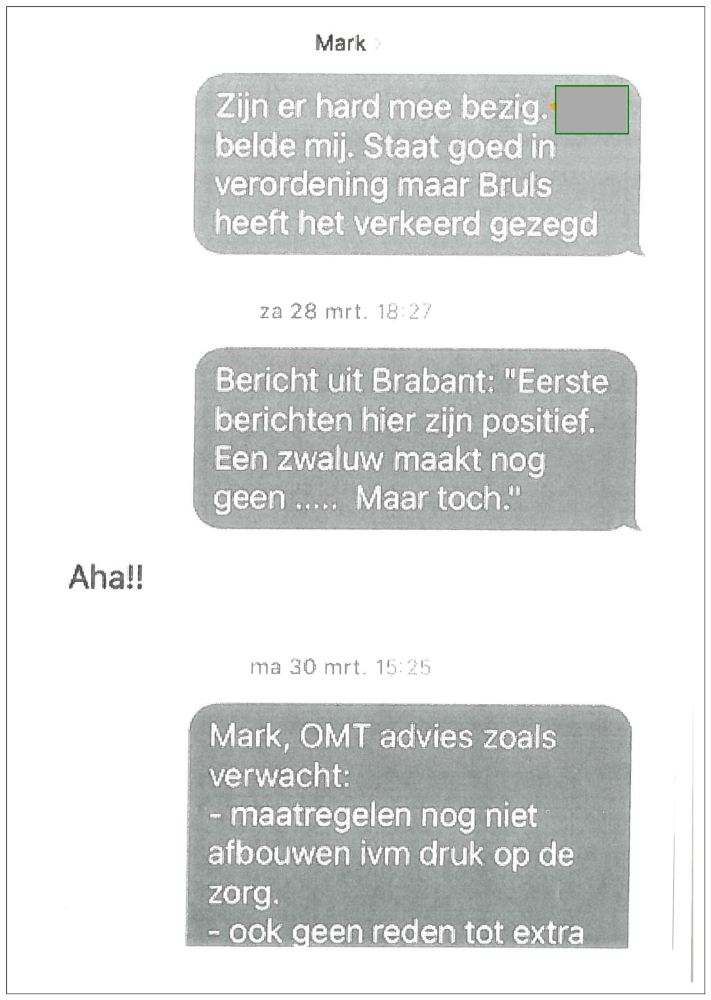

In [769]:
visualize_bounding_boxes('c-sms-berichten-mp-sg-26.png',
                           '../dataset/test/classic_test_LRE.json',
                           '../model_outputs/MaskRCNN_clean/coco_instances_results.json')

torch.Size([3, 2550, 3300])


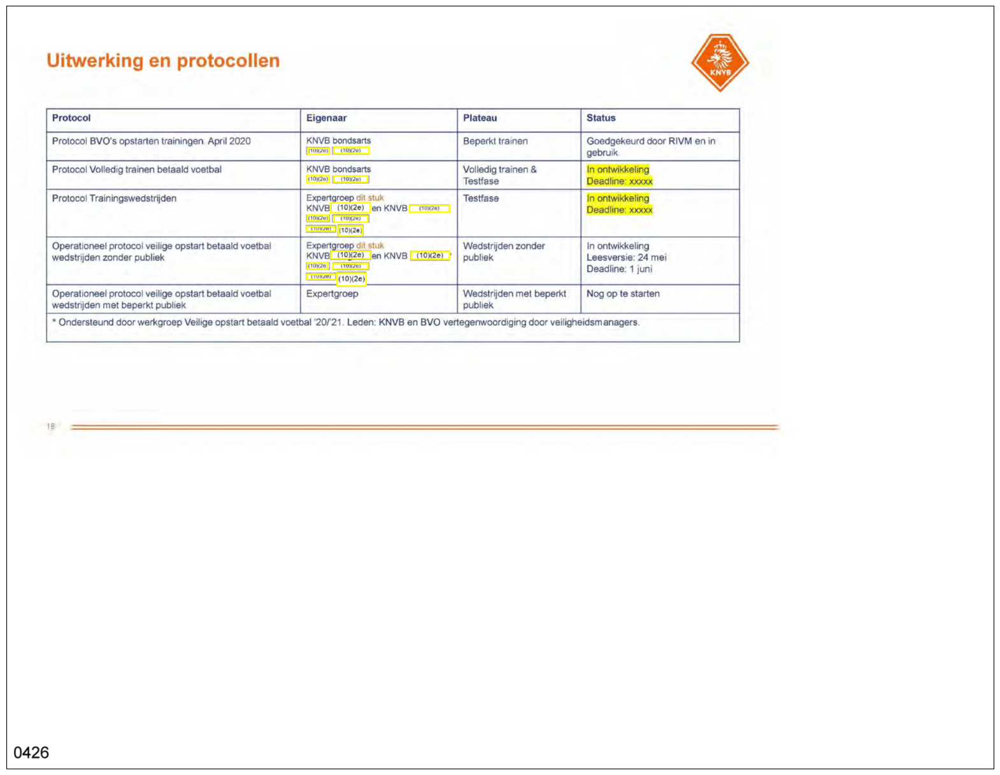

In [816]:
visualize_bounding_boxes('nl.mnre1058.2i.2022.1.misc.9-31.png',
                           '../dataset/test/extended_test_LRE.json',
                           '../model_outputs/Mask2Former_extended/coco_instances_results.json')

torch.Size([3, 2550, 3300])


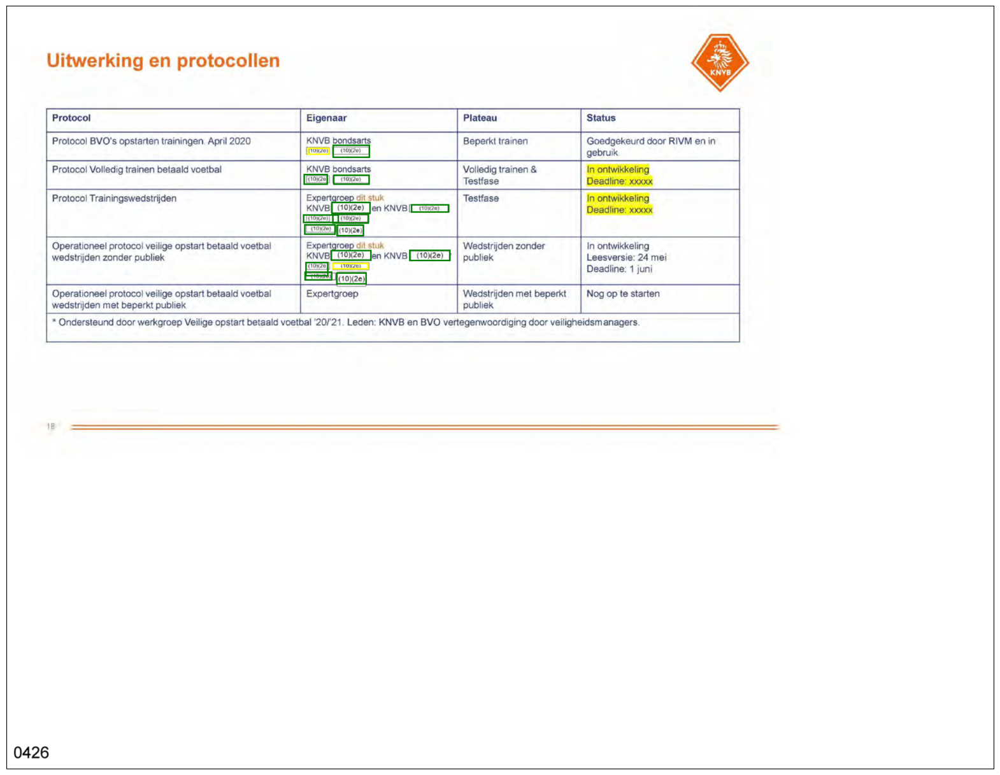

In [815]:
visualize_bounding_boxes('nl.mnre1058.2i.2022.1.misc.9-31.png',
                           '../dataset/test/classic_test_LRE.json',
                           '../model_outputs/Mask2Former_clean/coco_instances_results.json')

In [572]:
model_output_maskrcnn_clean = evaluate_model_predictions('../dataset/test/classic_test_LRE.json', '../model_outputs/MaskRCNN_clean/coco_instances_results.json',
                                         score_treshold = 0.7)

100%|█████████████████████████████████████████| 284/284 [00:42<00:00,  6.71it/s]


In [770]:
model_output_mask2former_clean = evaluate_model_predictions('../dataset/test/classic_test_LRE.json', '../model_outputs/Mask2Former_clean/coco_instances_results.json',
                                         score_treshold = 0.7)

100%|█████████████████████████████████████████| 284/284 [00:35<00:00,  8.02it/s]


In [778]:
model_output_mask2former_clean[model_output_mask2former_clean['type'] == 'black'].sort_values('FN',
                                                                                             ascending=False).head(10)

,TP,FP,FN,IOU,type
wob_verzoek_stukken_hondenverbod_kop_van_jut-964275-page1.png,37,11,15,28.739617,black
773. RE_ Flap college B&W de Meervaart 2_Geredigeerd-1.png,27,5,8,21.974386,black
122. overleg over Overlast en andere zaken-1.png,45,2,6,35.668166,black
IMAGES_00000_00000_14175046-1.png,39,3,4,32.515229,black
10. Verslag_Staf_Saskia_Groenewoud_1_april_2019 zonder markering-3.png,38,3,4,30.12391,black
10. Verslag_Staf_Saskia_Groenewoud_1_april_2019 zonder markering-1.png,18,3,4,15.054521,black
292. RE_ te plannen afspraak wethoud met vertegen_-2.png,40,1,4,32.329656,black
IMAGES_00000_00000_14175046-2-1.png,40,2,3,33.183491,black
0680. RE OD - toezicht bouw en woningtoezicht - Grimburgwal(1)_ocr-1.png,36,1,3,30.161312,black
944. korte terugkoppeling sessie team GO_Geredigeerd-1.png,13,2,3,10.704859,black


torch.Size([3, 3504, 2479])


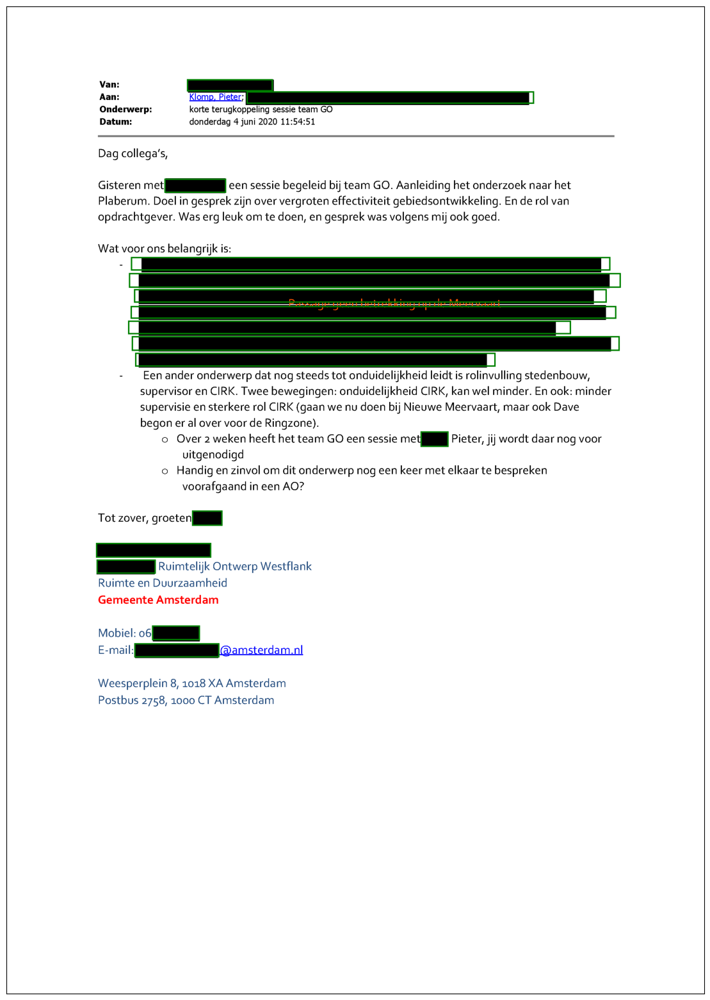

In [780]:
visualize_bounding_boxes('944. korte terugkoppeling sessie team GO_Geredigeerd-1.png',
                           '../dataset/test/classic_test_LRE.json',
                           '../model_outputs/MaskRCNN_clean/coco_instances_results.json')

In [767]:
model_output_maskrcnn_clean[model_output_maskrcnn_clean['type'] == 'gray']['']

,TP,FP,FN,IOU,type
c-sms-berichten-mp-sg-2.png,2,0,0,1.870074,gray
nl.mnre1058.2i.2022.1.misc.9-50.png,1,0,0,0.926003,gray
beslisnota-bij-geannoteerde-agenda-formele-energieraad-28-03-1.png,17,0,2,13.082408,gray
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-92.png,13,0,0,11.58501,gray
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-79.png,1,0,0,0.87467,gray
...,...,...,...,...,...
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-134.png,1,0,0,0.908208,gray
documenten-180-226-81.png,26,0,8,21.168348,gray
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-109.png,13,0,0,11.800722,gray
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-74.png,14,0,0,12.3191,gray


  0%|                                                    | 0/51 [00:00<?, ?it/s]

Documenten bij Woo-besluit over rapporten The Hague Centre for Strategic Studies _HCSS_page014-001.png
torch.Size([3, 3508, 2480])


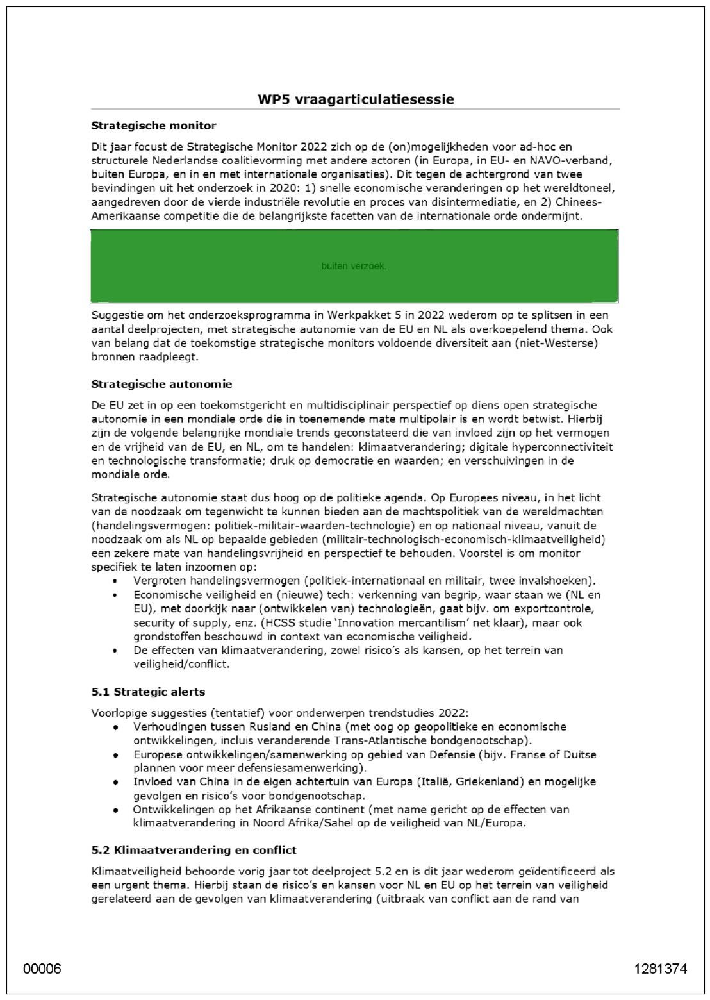

  2%|▊                                           | 1/51 [00:02<01:51,  2.23s/it]

woo-niet-evacueren-medewerkers-atvet-documenten-5.png
torch.Size([3, 3504, 2478])


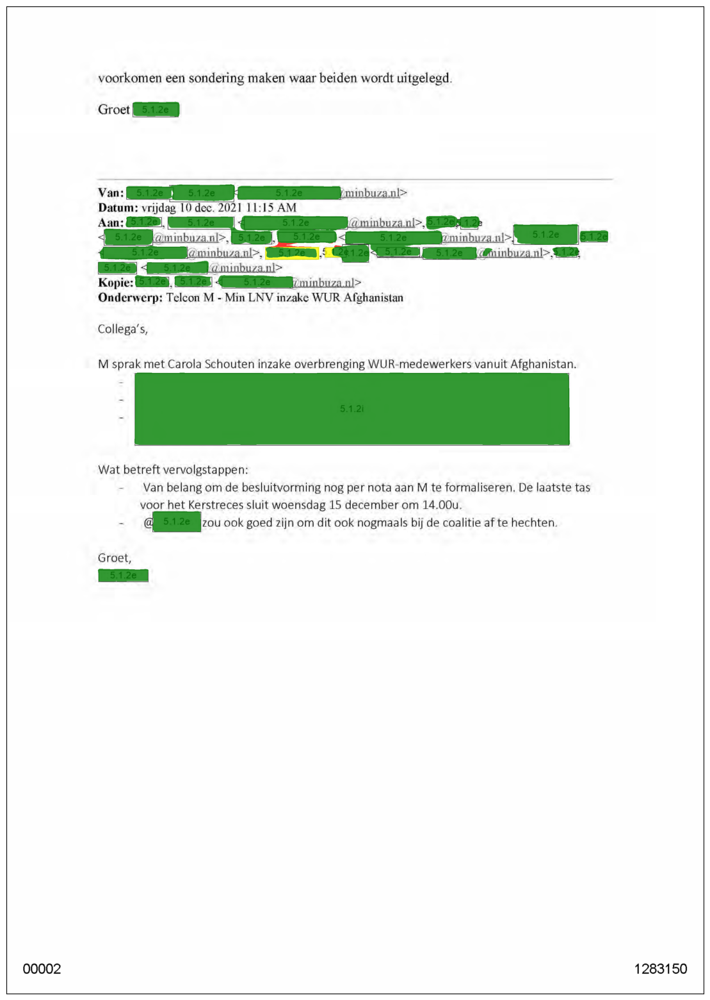

  4%|█▋                                          | 2/51 [00:06<02:58,  3.65s/it]

nl.mnre1058.2i.2022.1.misc.9-5.png
torch.Size([3, 3300, 2550])


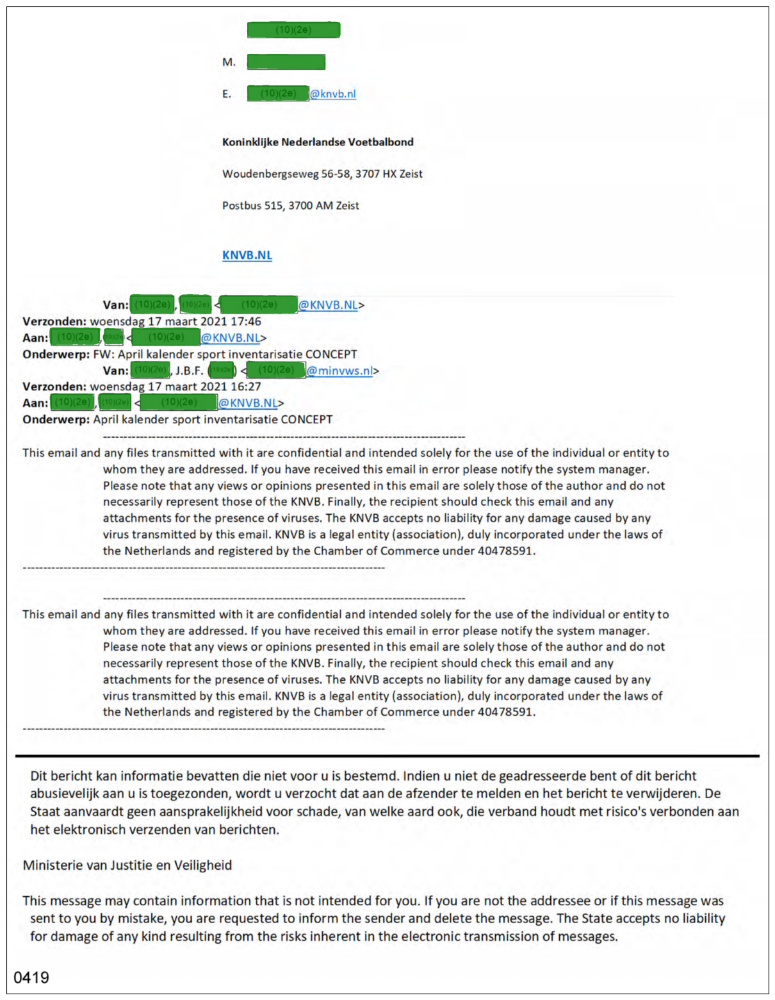

  6%|██▌                                         | 3/51 [00:10<02:54,  3.63s/it]

BESLUIT_Beslissing Stiath 060423_b_page024-001.png
torch.Size([3, 3508, 2480])


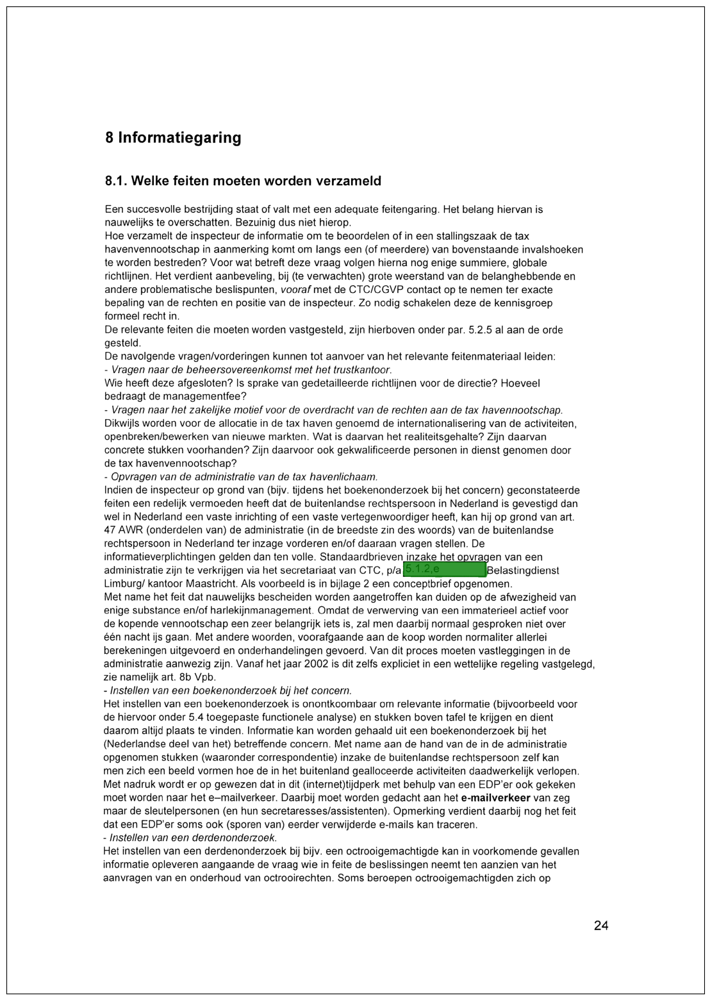

  8%|███▍                                        | 4/51 [00:12<02:17,  2.92s/it]

Binder OneLove_page131-001.png
torch.Size([3, 3508, 2480])


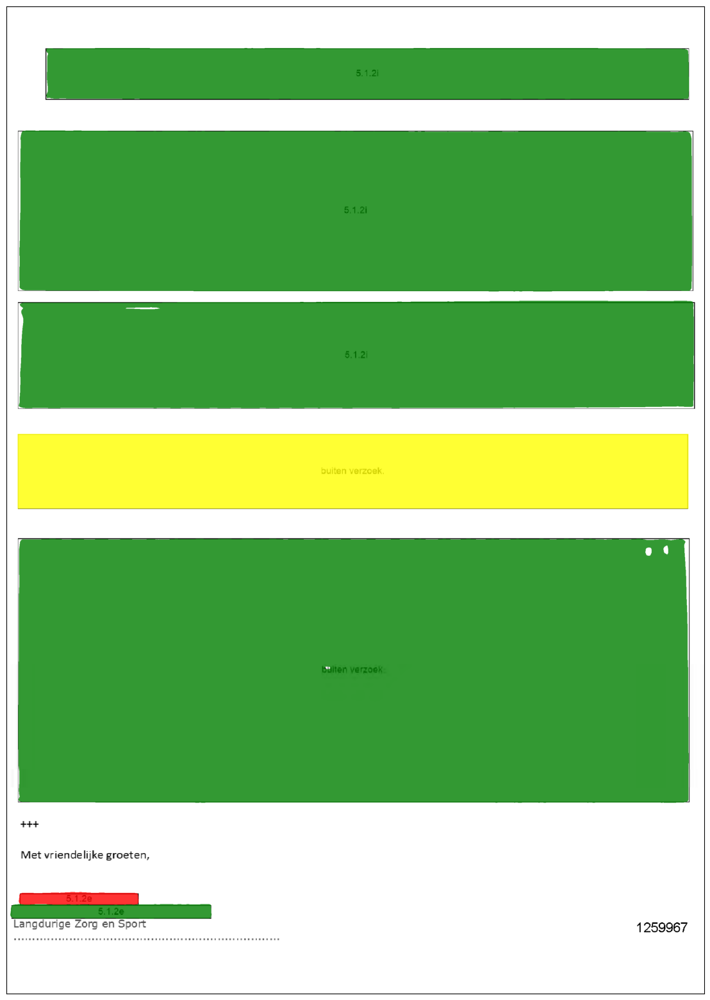

 10%|████▎                                       | 5/51 [00:14<02:08,  2.80s/it]

nl.mnre1058.2i.2022.1.misc.9-52.png
torch.Size([3, 3300, 2550])


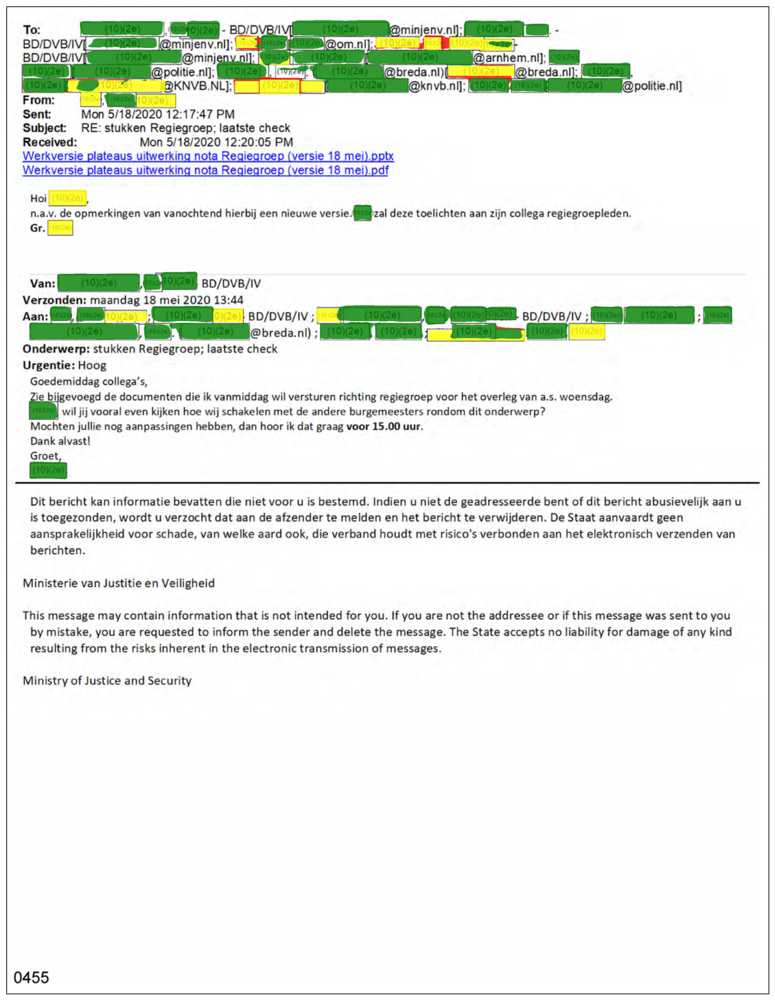

 12%|█████▏                                      | 6/51 [00:27<04:43,  6.29s/it]

nl.mnre1058.2i.2022.1.misc.9-46.png
torch.Size([3, 3300, 2550])


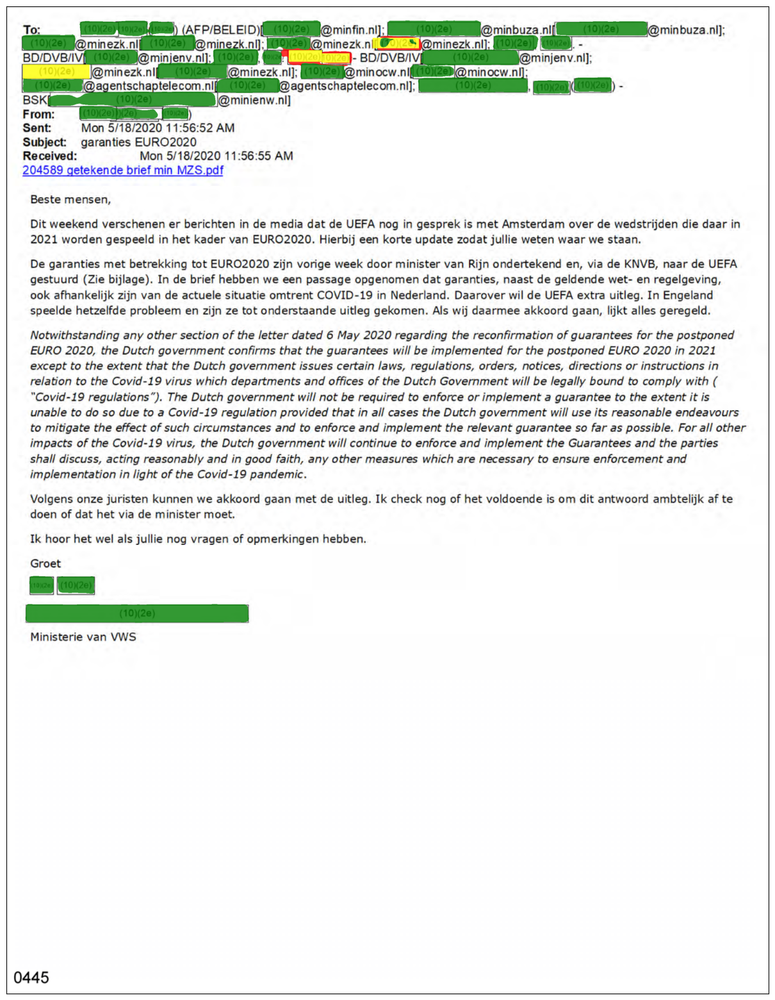

 14%|██████                                      | 7/51 [00:33<04:31,  6.16s/it]

woo-niet-evacueren-medewerkers-atvet-documenten-7.png
torch.Size([3, 3504, 2478])


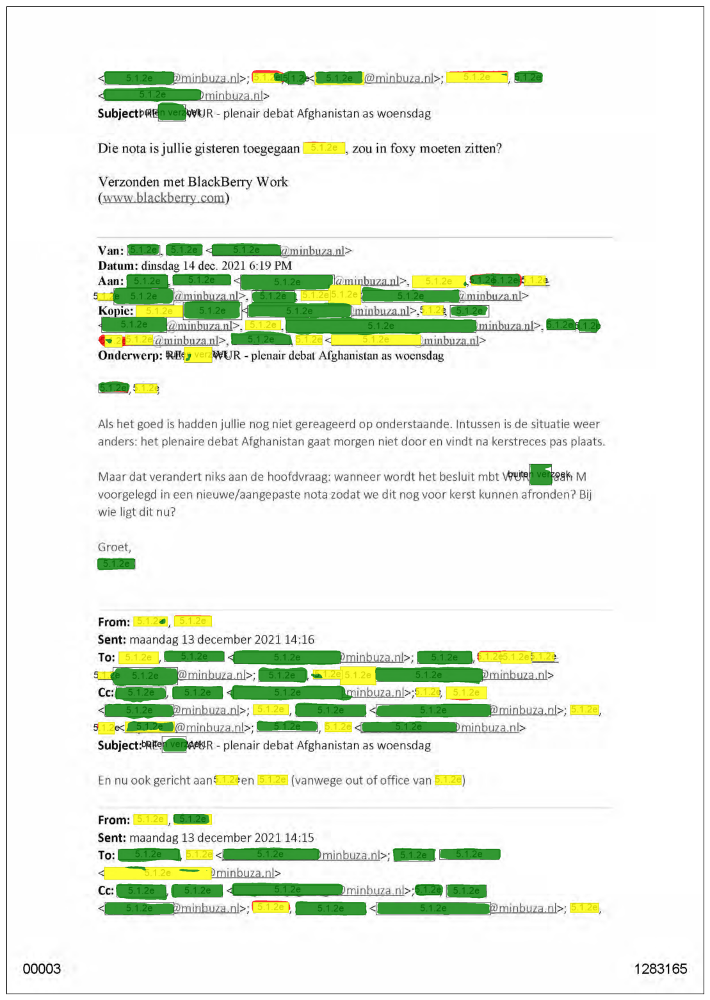

 16%|██████▉                                     | 8/51 [00:54<07:44, 10.80s/it]

woo-kennisgroepstandpunten-formeel-recht-deelbesluit-2-documenten_page009-001.png
torch.Size([3, 3508, 2480])


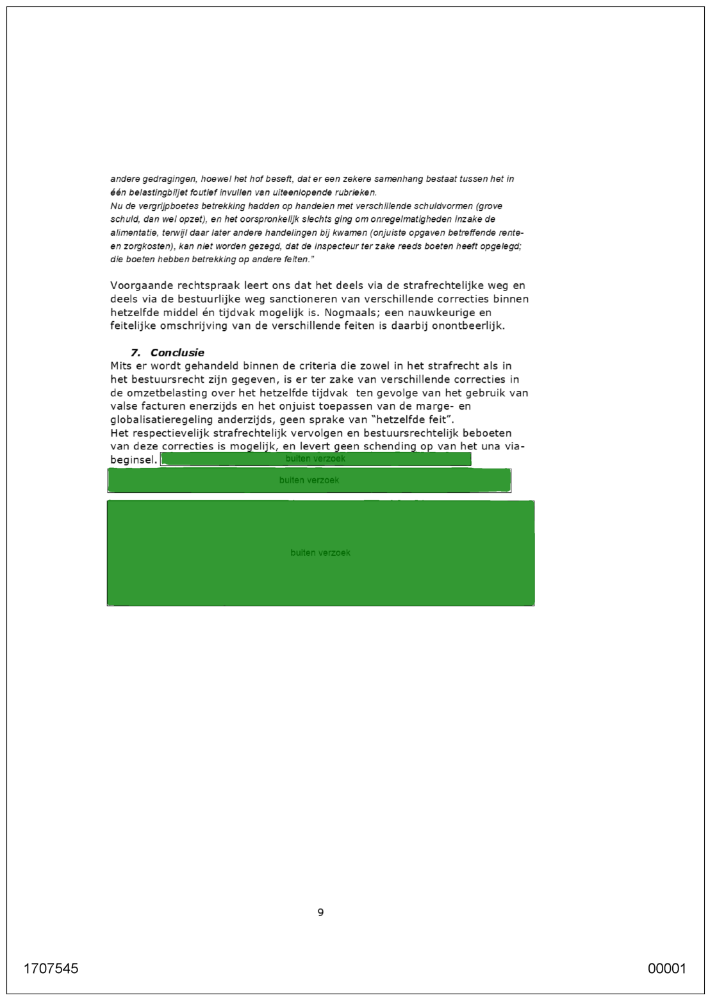

 18%|███████▊                                    | 9/51 [00:56<05:36,  8.01s/it]

nl.mnre1058.2i.2022.1.misc.9-42.png
torch.Size([3, 2550, 3300])


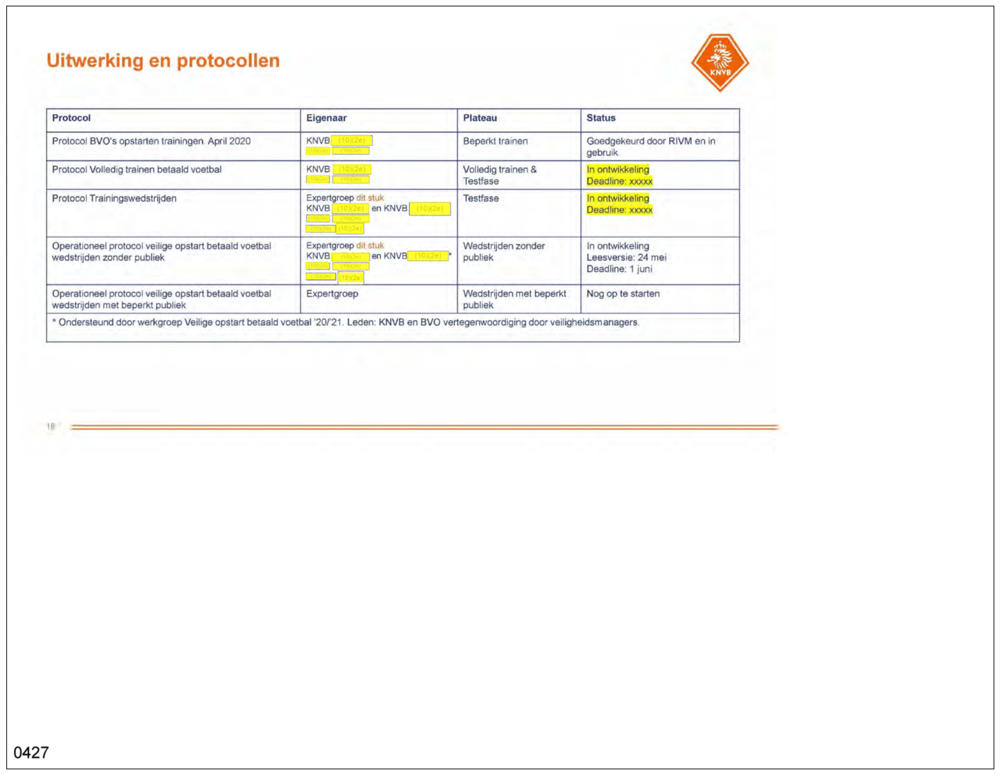

 20%|████████▍                                  | 10/51 [00:59<04:24,  6.45s/it]

nl.mnre1058.2i.2022.1.misc.9-56.png
torch.Size([3, 3300, 2550])


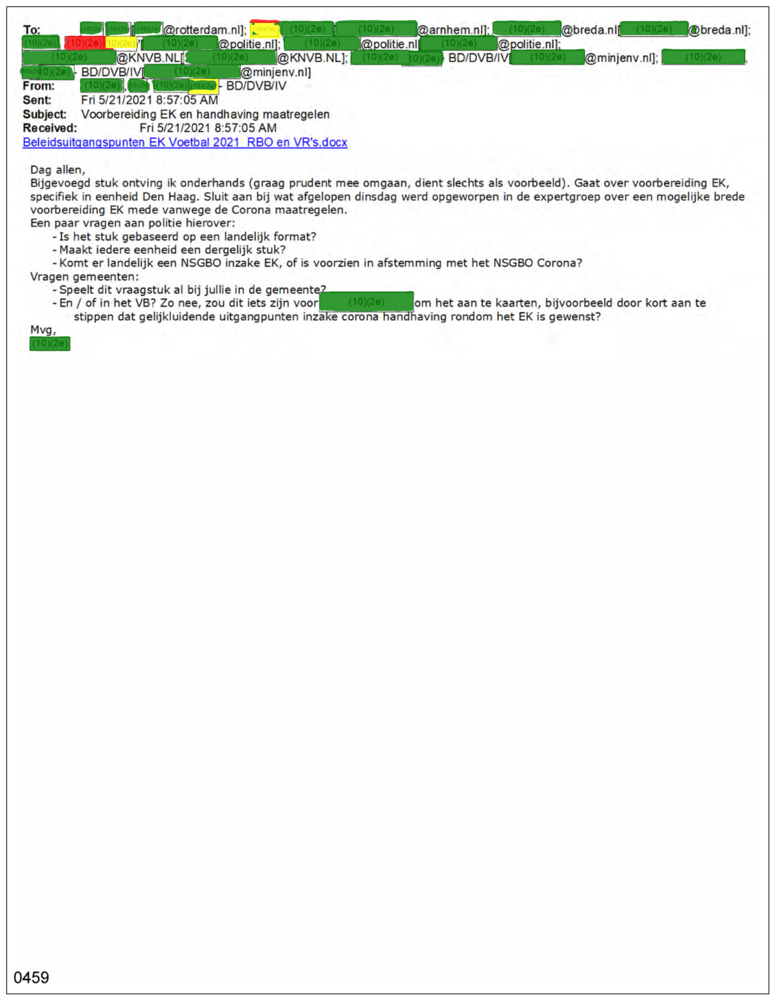

 22%|█████████▎                                 | 11/51 [01:03<03:45,  5.63s/it]

Binder OneLove_page005-001.png
torch.Size([3, 3508, 2480])


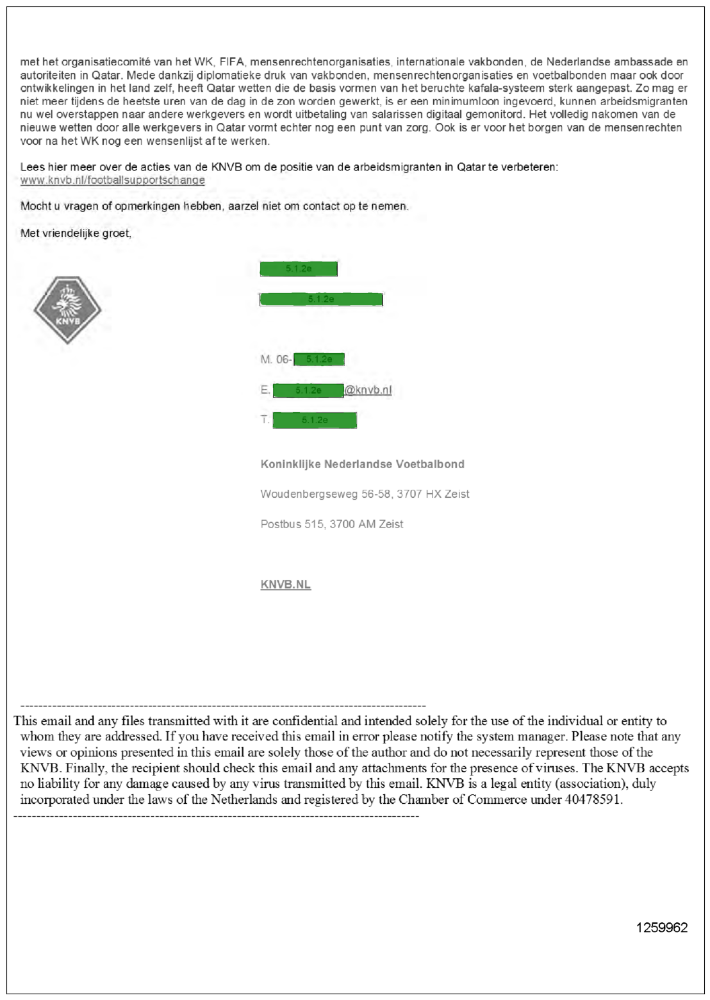

 24%|██████████                                 | 12/51 [01:05<02:58,  4.58s/it]

Documenten bij Woo-besluit over rapporten The Hague Centre for Strategic Studies _HCSS_-3.png
torch.Size([3, 3507, 2478])


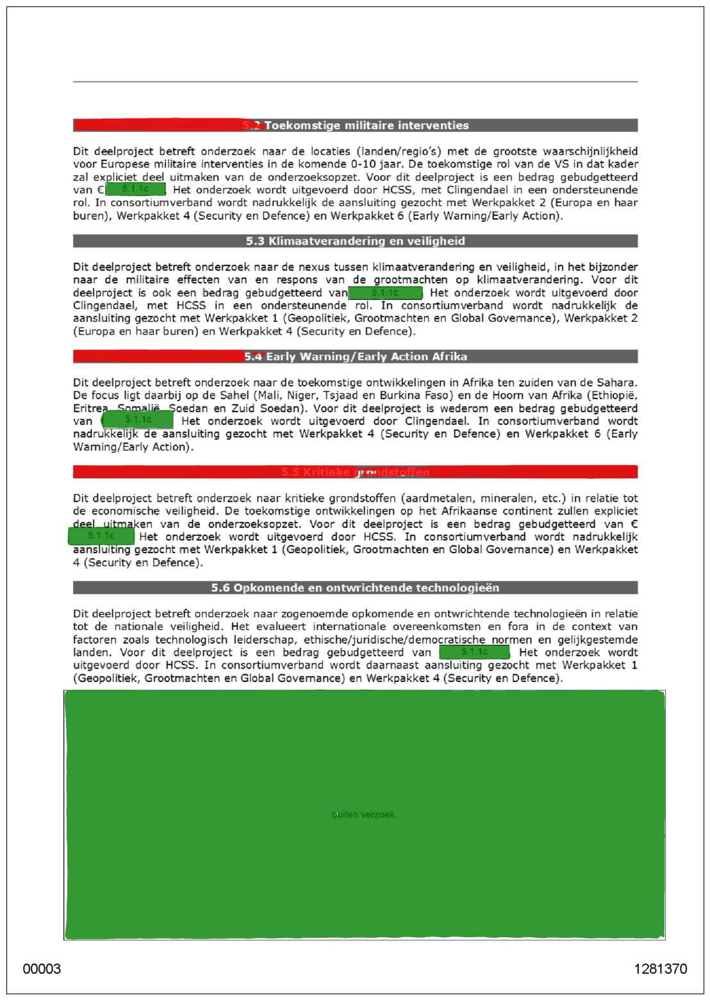

 25%|██████████▉                                | 13/51 [01:07<02:25,  3.83s/it]

nl.mnre1058.2i.2022.1.misc.9-57.png
torch.Size([3, 3300, 2550])


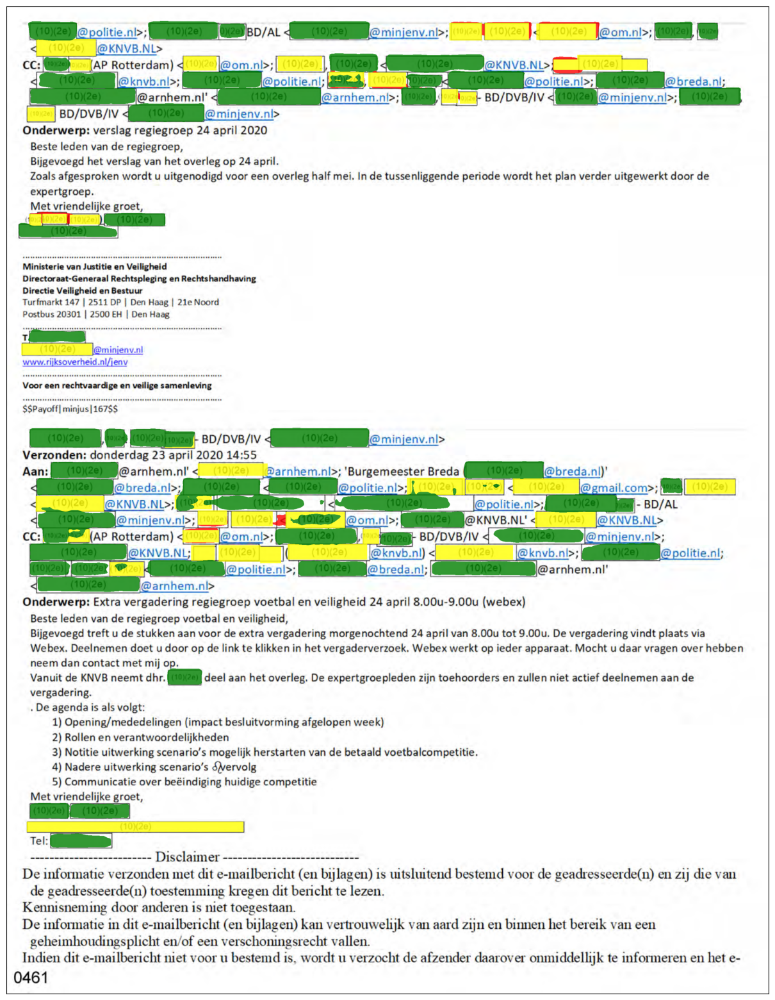

 27%|███████████▊                               | 14/51 [01:24<04:44,  7.70s/it]

woo-niet-evacueren-medewerkers-atvet-documenten-2.png
torch.Size([3, 3513, 2490])


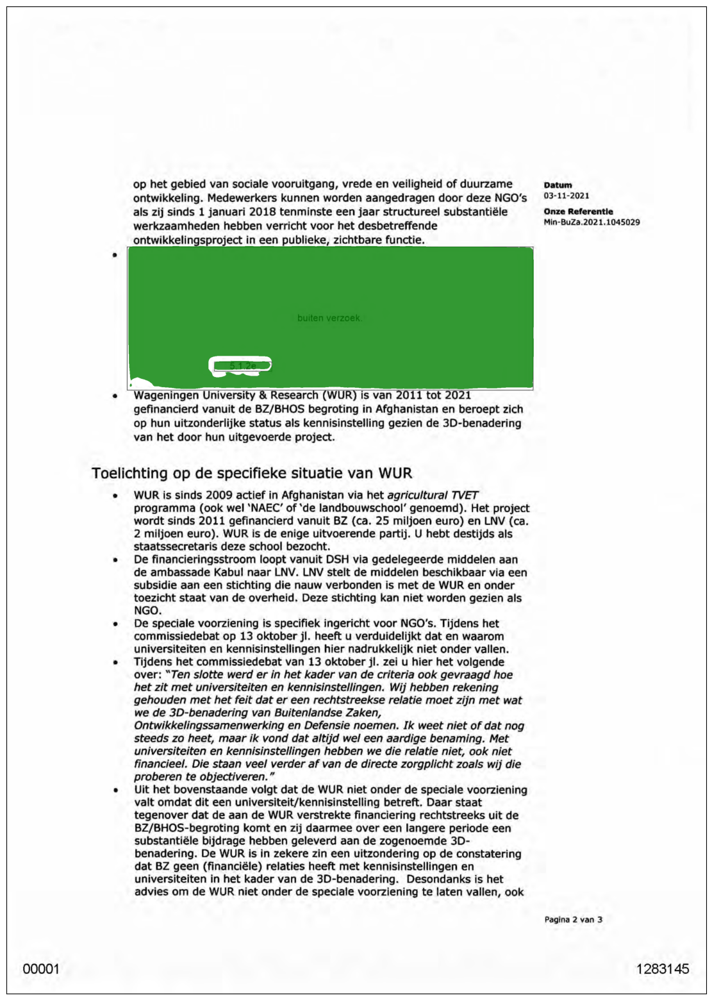

 29%|████████████▋                              | 15/51 [01:26<03:34,  5.97s/it]

nl.mnre1058.2i.2022.1.misc.9-55.png
torch.Size([3, 3300, 2550])


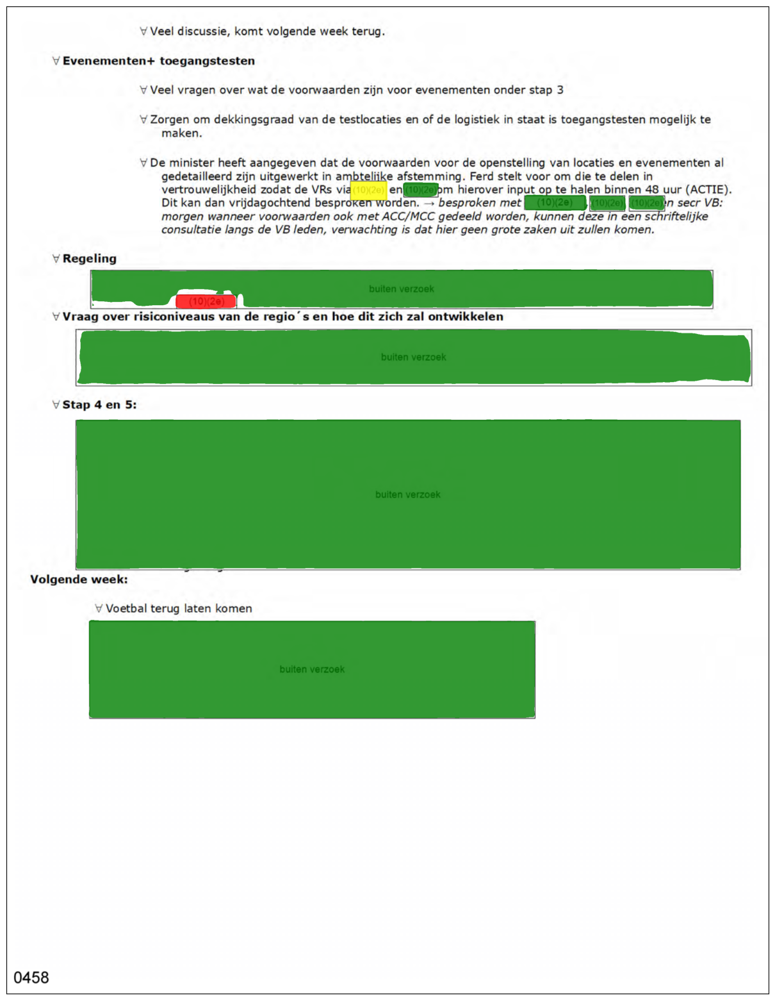

 31%|█████████████▍                             | 16/51 [01:28<02:54,  4.99s/it]

Ordner2+doc+51-100-19.png
torch.Size([3, 3300, 2550])


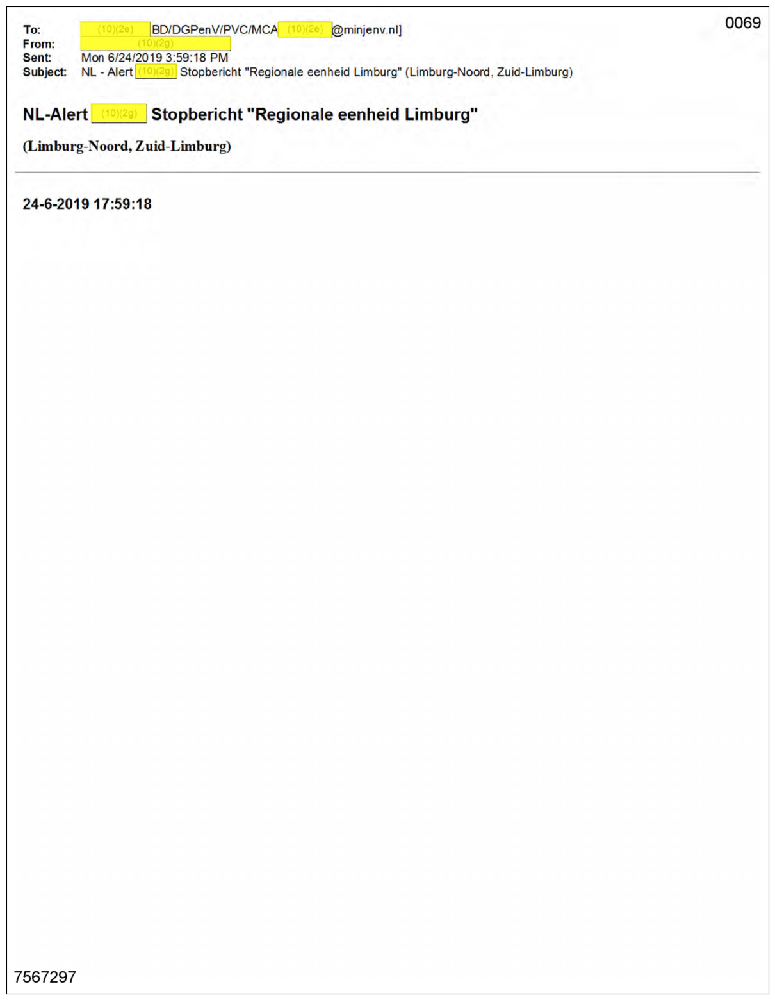

 33%|██████████████▎                            | 17/51 [01:30<02:17,  4.05s/it]

Ordner2+doc+51-100-25.png
torch.Size([3, 3300, 2550])


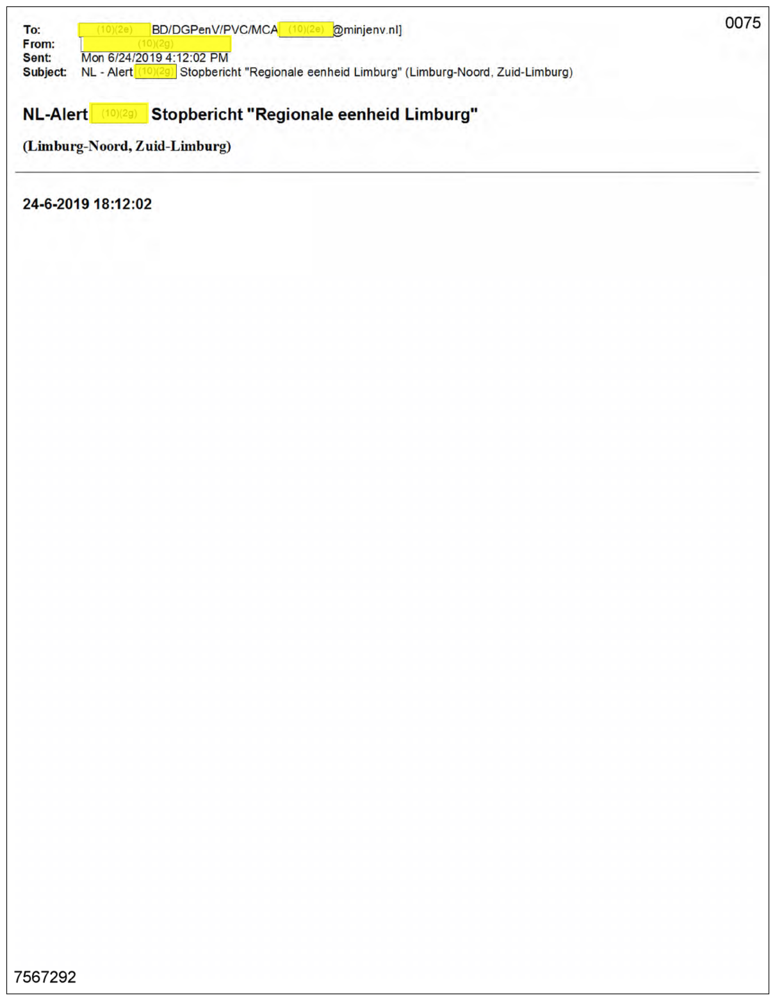

 35%|███████████████▏                           | 18/51 [01:32<01:54,  3.46s/it]

Bijlagen deel 2 bij Woo-besluit bijverdiensten bestuurders semipublieke sector _WNT_page015-001.png
torch.Size([3, 3508, 2480])


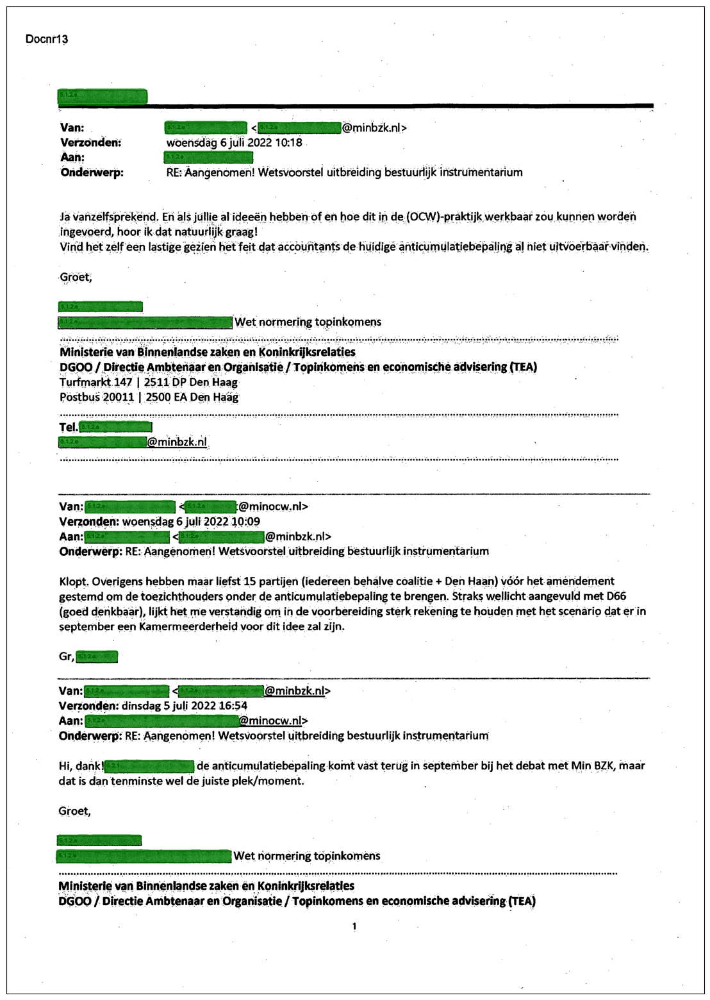

 37%|████████████████                           | 19/51 [01:35<01:43,  3.25s/it]

Ordner2+doc+51-100-30.png
torch.Size([3, 3300, 2550])


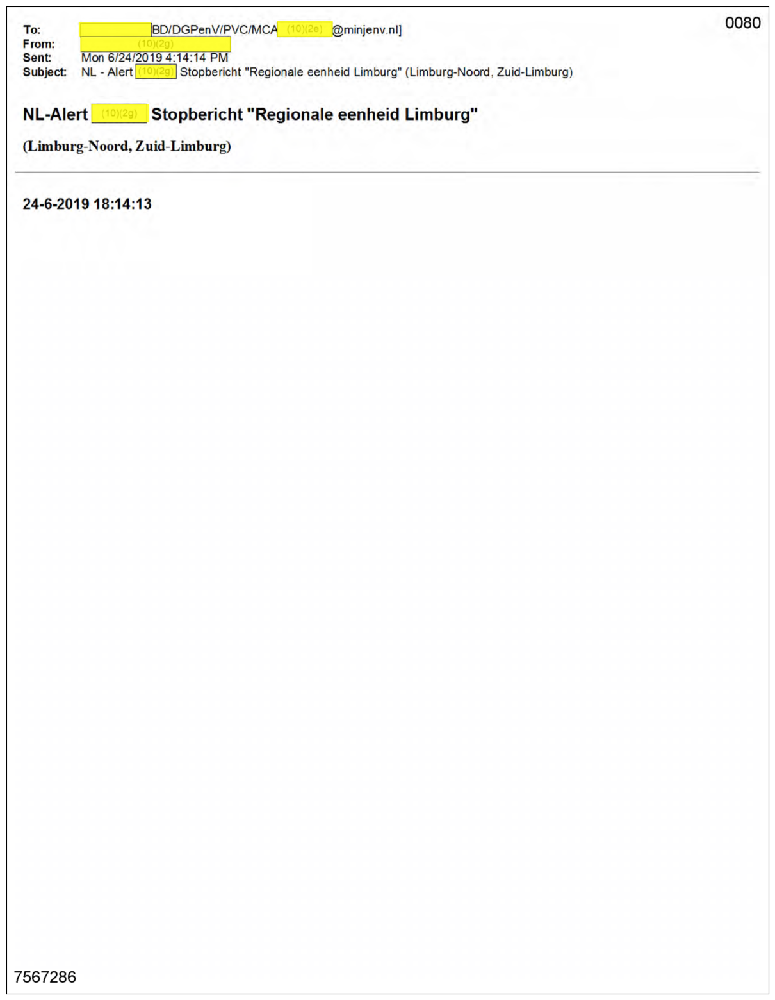

 39%|████████████████▊                          | 20/51 [01:37<01:29,  2.90s/it]

Documenten bij Woo-besluit over correspondentie tussen besturen bij totstandkoming rapport Perspectief voor de Gnephoek eo-24.png
torch.Size([3, 3493, 2461])


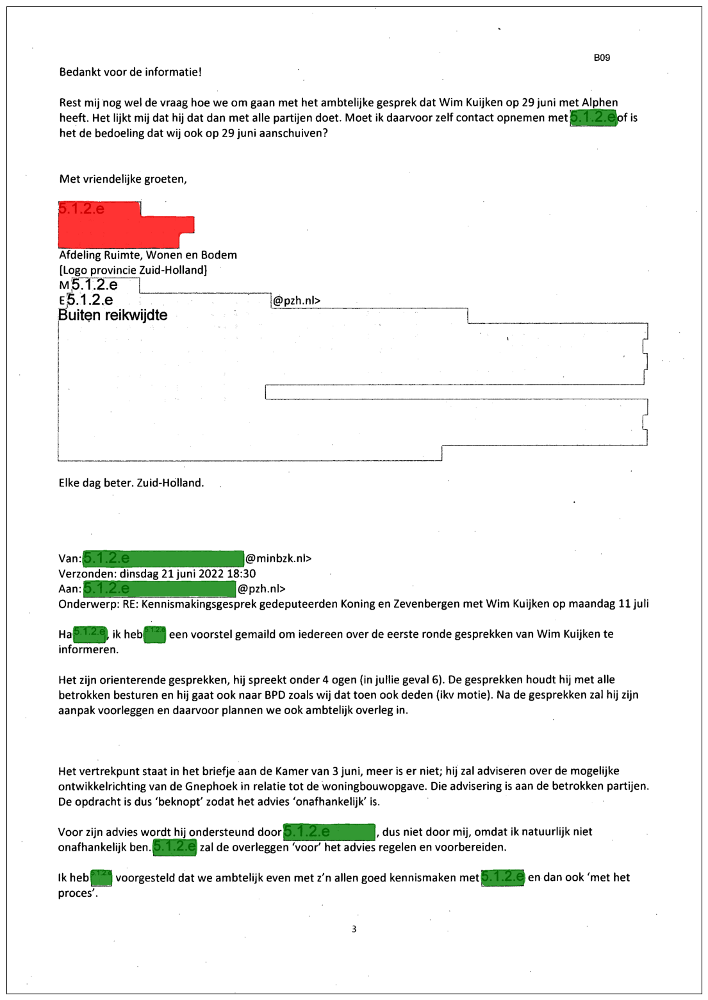

 41%|█████████████████▋                         | 21/51 [01:40<01:23,  2.79s/it]

nl.mnre1058.2i.2022.1.misc.9-54.png
torch.Size([3, 3300, 2550])


 41%|█████████████████▋                         | 21/51 [01:43<02:27,  4.92s/it]

KeyboardInterrupt



In [592]:
for item in tqdm(model_output_maskrcnn_clean[model_output_maskrcnn_clean['type'] == 'border'].index.tolist()):
    print(item)
    visualize_annotations('nl.mnre1058.2i.2022.1.misc.9-52.png',
                               '../dataset/test/extended_test_LRE.json',
                               '../model_outputs/Mask2Former_extended/coco_instances_results.json')

In [15]:
def metric_calculation(dataframe):
    '''
    The metric calculations as done in https://github.com/irlabamsterdam/TPDLTextRedaction/blob/main/notebooks/Experiments.ipynb
    @param  pd.DataFrame    The dataframe for one class with the following columns { IOU, TP, FN, FP }
                            where the IOU is the sum of IOU scores and the others a total count.
    @return dict            The metric scores for this class
    '''
    
    SQ = dataframe['IOU'].sum() / dataframe['TP'].sum() if dataframe['TP'].sum() > 0 else 0
    RQ = dataframe['TP'].sum() / (dataframe['TP'].sum() + 0.5*dataframe['FN'].sum() + 0.5*dataframe['FP'].sum())
    
    PQ = SQ*RQ
    
    P = dataframe['TP'].sum() / (dataframe['TP'].sum() + dataframe['FP'].sum())
    R = dataframe['TP'].sum() / (dataframe['TP'].sum() + dataframe['FN'].sum())
    
    return { 'PQ': round(PQ, 2), 'SQ': round(SQ, 2), 'RQ': round(RQ, 2), 'P': round(P, 2), 'R': round(R, 2) }

In [348]:
metric_calculation(model_output)

{'PQ': 0.76, 'SQ': 0.84, 'RQ': 0.9, 'P': 0.93, 'R': 0.88}

In [512]:
model_output[model_output['IOU'] > 0].sort_values('IOU')

,TP,FP,FN,IOU,type
c-sms-berichten-mp-sg-14.png,1,0,1,0.531415,gray
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-160.png,1,0,0,0.777933,gray
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-154.png,1,0,0,0.778967,gray
Afschift besluit Wob-verzoek-7.png,1,0,0,0.786839,black
Bijlagen bij besluit Woo-verzoek over verantwoord medicijngebruik-18.png,1,0,0,0.793944,gray
...,...,...,...,...,...
nl.mnre1058.2i.2022.1.misc.9-57.png,61,16,41,48.329248,border
nl.mnre1058.2i.2022.1.misc.9-52.png,62,10,20,48.812043,border
woo-niet-evacueren-medewerkers-atvet-documenten-9.png,60,3,13,48.821457,border
woo-niet-evacueren-medewerkers-atvet-documenten-7.png,62,13,44,48.92348,border


In [350]:
model_output[model_output['type'] == 'no_annotation']['FP'].sum()

8

In [747]:
from sklearn.model_selection import StratifiedShuffleSplit
# write a function that can work with our nice COCO formats so that we can easily to train test splits on the cluster.
def create_stratified_json_files(train_json, dataframe_path, train_size: float=0.50):
    with open(train_json, 'r') as f:
        train_instances = json.load(f)
    
    page_info = pd.read_csv(dataframe_path)
    # make the splitter
    page_info = page_info.fillna('no_annotation')
    shuffler = StratifiedShuffleSplit(n_splits=1, test_size=1-train_size, random_state=0)
    splits = shuffler.get_n_splits(page_info['File'], page_info['type'])
    train_idx, test_idx = list(next(shuffler.split(page_info['File'], page_info['type'])))
    train_files, test_files = page_info['File'][train_idx], page_info['File'][test_idx]
    image_dict = {img_id: filename for img_id, filename in zip([item['id'] for item in train_instances['images']],
                                                              [item['file_name'] for item in train_instances['images']])}

    train_annotations = []
    test_annotations = []
    for instance in train_instances['annotations']:
        image_id = image_dict[instance['image_id']]
        if image_id in train_files.tolist():
            train_annotations.append(instance)
        else:
            test_annotations.extend(instance)
    train_instances['annotations'] = train_annotations
    train_instances['images'] = [image for image in train_instances['images'] if image['file_name'] in train_files.tolist()]
    print(len(train_instances['images']))
    return train_instances
    

In [749]:
for split in tqdm([20, 40, 60, 80]):
    split_file = create_stratified_json_files('../dataset/train/extended_train.json',
                                '../dataset/data_complete.csv', train_size=split/100)
    new_name = '../dataset/test/train_%d.json' % split
    with open(new_name, 'w') as f:
        json.dump(split_file, f)

 25%|███████████▎                                 | 1/4 [00:00<00:00,  4.42it/s]

211


 50%|██████████████████████▌                      | 2/4 [00:00<00:00,  4.46it/s]

418


 75%|█████████████████████████████████▊           | 3/4 [00:00<00:00,  3.97it/s]

610


100%|█████████████████████████████████████████████| 4/4 [00:01<00:00,  3.84it/s]

821


In [736]:
maskrcnn20= evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/MaskRCNN20/coco_instances_results.json',
                                         score_treshold = 0.5)

100%|█████████████████████████████████████████| 439/439 [00:32<00:00, 13.68it/s]


In [737]:
maskrcnn40= evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/MaskRCNN40/coco_instances_results.json',
                                         score_treshold = 0.5)

100%|█████████████████████████████████████████| 439/439 [00:32<00:00, 13.48it/s]


In [738]:
maskrcnn60 = evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/MaskRCNN60/coco_instances_results.json',
                                         score_treshold = 0.5)

100%|█████████████████████████████████████████| 439/439 [00:30<00:00, 14.19it/s]


In [739]:
maskrcnn80 = evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/MaskRCNN80/coco_instances_results.json',
                                         score_treshold = 0.5)

100%|█████████████████████████████████████████| 439/439 [00:29<00:00, 14.81it/s]


In [740]:
metric_calculation(maskrcnn20)

{'PQ': 0.76, 'SQ': 0.84, 'RQ': 0.91, 'P': 0.86, 'R': 0.96}

In [741]:
metric_calculation(maskrcnn40)

{'PQ': 0.76, 'SQ': 0.85, 'RQ': 0.9, 'P': 0.83, 'R': 0.97}

In [742]:
metric_calculation(maskrcnn60)

{'PQ': 0.77, 'SQ': 0.85, 'RQ': 0.9, 'P': 0.85, 'R': 0.96}

In [743]:
metric_calculation(maskrcnn80)

{'PQ': 0.76, 'SQ': 0.82, 'RQ': 0.92, 'P': 0.87, 'R': 0.96}

In [801]:
mask2former_clean = evaluate_model_predictions('../dataset/test/classic_test_LRE.json', '../model_outputs/Mask2Former_clean/coco_instances_results.json',
                                         score_treshold = 0.7)

100%|█████████████████████████████████████████| 284/284 [01:48<00:00,  2.62it/s]

[[1.         0.10141592]
 [0.10141592 1.        ]]


In [802]:
mask2former_extended = evaluate_model_predictions('../dataset/test/extended_test_LRE.json', '../model_outputs/Mask2Former_extended/coco_instances_results.json',
                                         score_treshold = 0.7)

100%|█████████████████████████████████████████| 439/439 [02:09<00:00,  3.39it/s]

[[1.         0.11927504]
 [0.11927504 1.        ]]


In [808]:
a = mask2former_extended[mask2former_extended['type'] !='no_annotation']['FN'].sort_index() - mask2former_clean['FN'].sort_index()

In [812]:
a.sort_values(ascending=False)

Ordner1+doc+1-50-30.png                                                                                                               33
nl.mnre1058.2i.2022.1.misc.9-31.png                                                                                                   15
nl.mnre1058.2i.2022.1.misc.9-42.png                                                                                                   15
woo-niet-evacueren-medewerkers-atvet-documenten-7.png                                                                                 11
Bijlagen 2 bij Besluit op Woo-verzoek over uitvoering geven door de Staat aan het vonnis van de rechtbank van 14 april 2021-13.png     6
                                                                                                                                      ..
nl.mnre1058.2i.2022.1.misc.9-57.png                                                                                                   -3
wob_verzoek_stukken_hondenverbod_kop_van_